<a href="https://colab.research.google.com/github/MohamedElSobkey/Train-YOLO11-Object-Detection-Model-on-a-Custom-Dataset/blob/main/Train_YOLO11_Object_Detection_Model_on_a_Custom_Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Train YOLO11 Object Detection Model on a Custom Dataset

In [1]:
!nvidia-smi

Tue Oct 15 13:46:57 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   67C    P8              13W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# Step 01 # Install the Ultralytics Package

In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 870.5/870.5 kB 26.9 MB/s eta 0:00:00


# Step 02 # Import All the Requried Libraries

In [3]:
import ultralytics
ultralytics.checks()

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 29.2/112.6 GB disk)


In [4]:
from ultralytics import YOLO
from IPython.display import Image

# Step # 03 Download Dataset from Roboflow

In [5]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="2T85NWF9m3FAtlCj3pKg")
project = rf.workspace("project-uyrxf").project("ppe_detection-v1x3l")
version = project.version(2)
dataset = version.download("yolov11")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.4/80.4 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.9 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to PPE_Detection-2 in yolov11:: 100%|██████████| 6472/6472 [00:01<00:00, 3959.93it/s]


In [6]:
dataset.location

'/content/PPE_Detection-2'

# Step # 04 Train YOLO11 Model on a Custom Dataset

In [7]:
!yolo task=detect mode=train data={dataset.location}/data.yaml model="yolo11n.pt" epochs=40 imgsz=640

100% 5.35M/5.35M [00:00<00:00, 96.8MB/s]
Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/PPE_Detection-2/data.yaml, epochs=40, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=Fa

# Step # 05 Examine Training Results

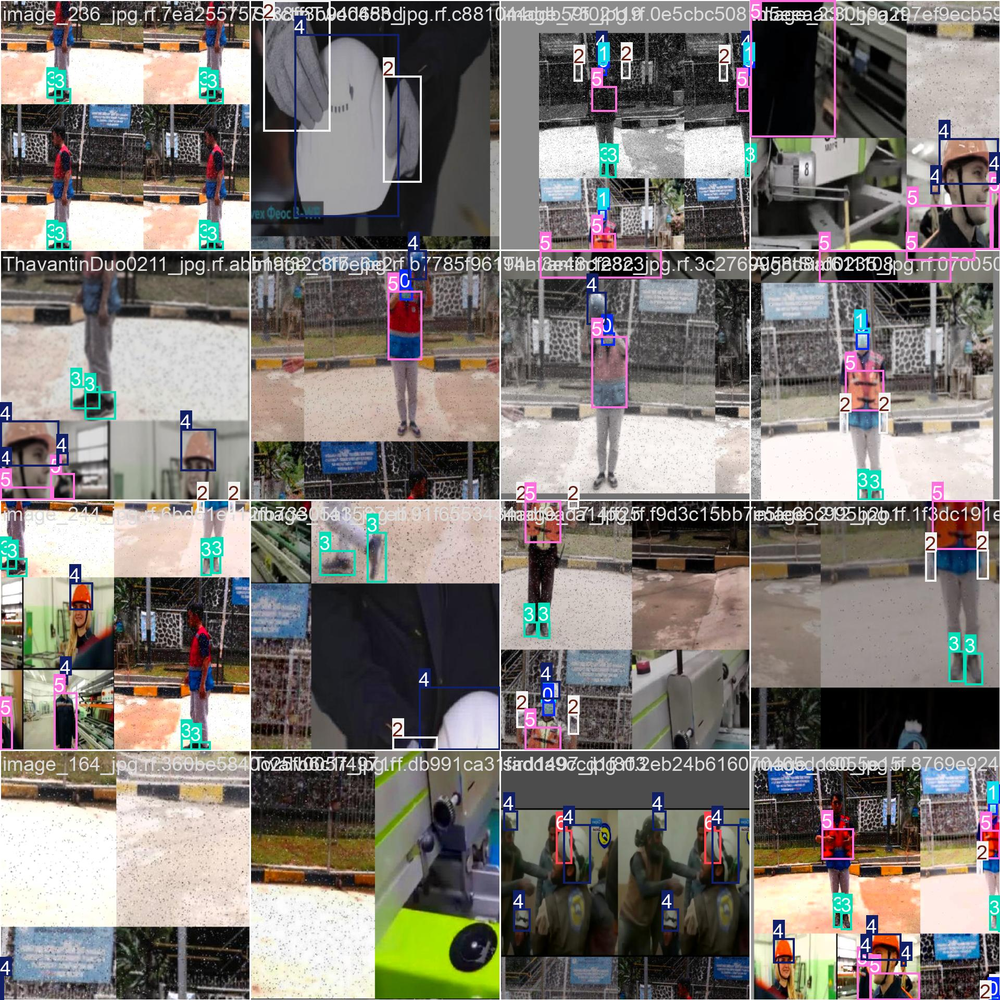

In [8]:
Image("/content/runs/detect/train/train_batch0.jpg", width=600)

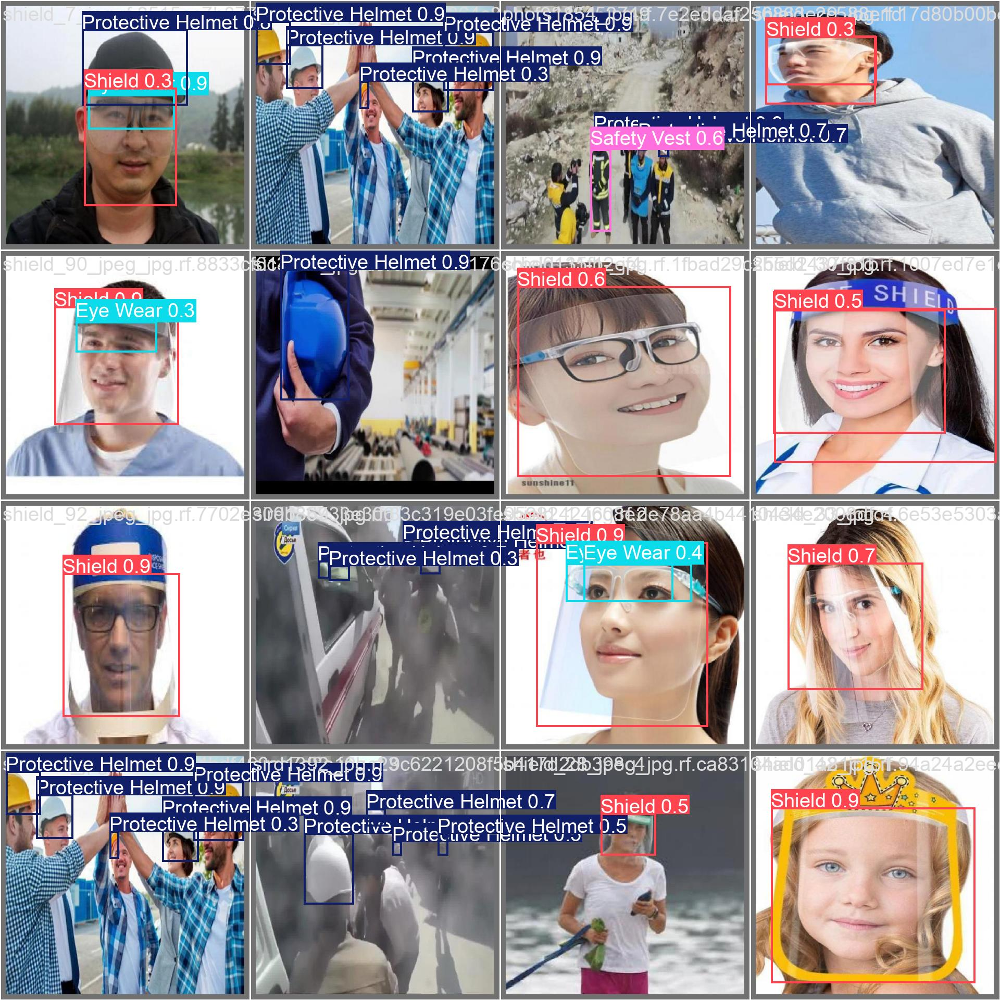

In [9]:
Image("/content/runs/detect/train/val_batch0_pred.jpg", width=600)

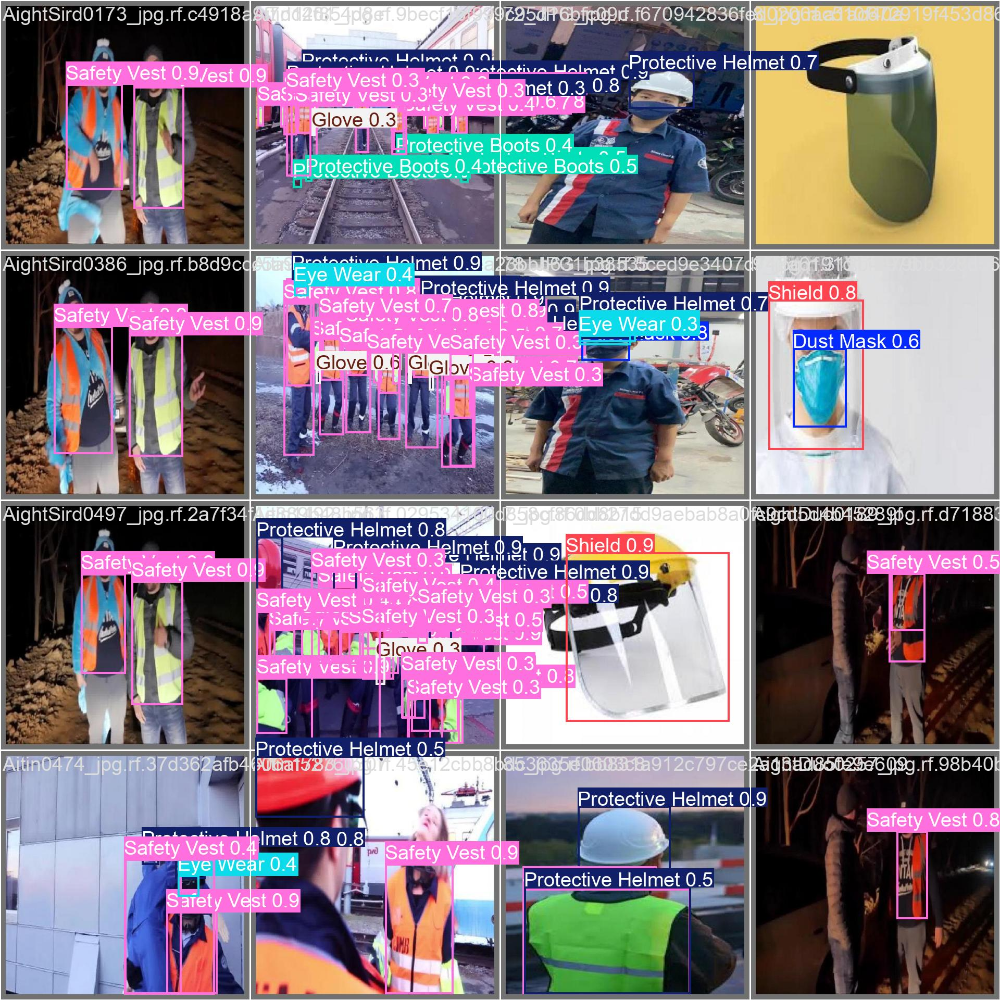

In [10]:
Image("/content/runs/detect/train/val_batch1_pred.jpg", width=600)

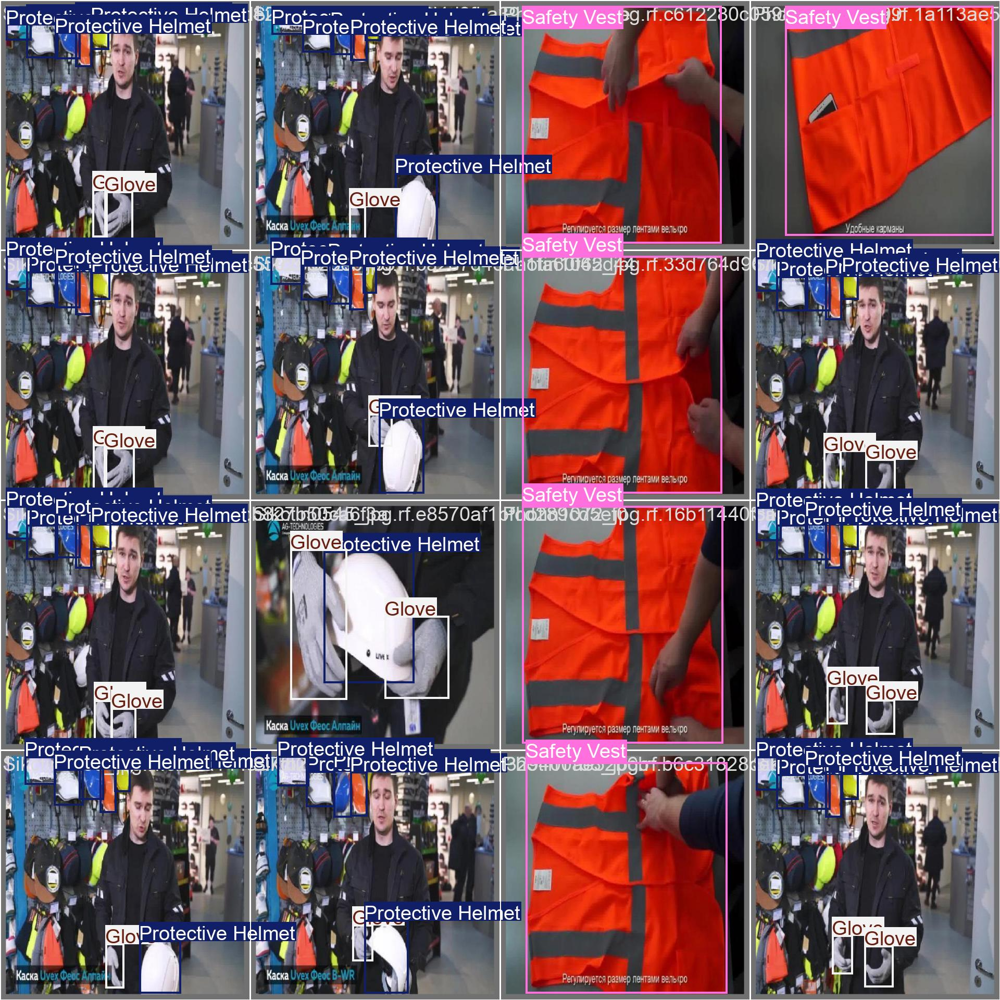

In [11]:
Image("/content/runs/detect/train/val_batch2_labels.jpg", width=600)

In [12]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [14]:
!mv /content/runs/detect/train/weights/best.pt /content/drive/MyDrive/yolov11

# Step # 06 Download the Model Weights from the Google Drive

In [15]:
!gdown "https://drive.google.com/uc?id=1-8SiXKNM23BW03uF-wqLdov4pNXi3mec&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=1-8SiXKNM23BW03uF-wqLdov4pNXi3mec&confirm=t
To: /content/best.pt
100% 5.47M/5.47M [00:00<00:00, 34.9MB/s]


# Step # 07 Validate Fine-Tuned Model

In [16]:
!yolo task=detect mode=val model="best.pt" data={dataset.location}/data.yaml

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,583,517 parameters, 0 gradients, 6.3 GFLOPs
val: Scanning /content/PPE_Detection-2/valid/labels.cache... 637 images, 0 backgrounds, 0 corrupt: 100% 637/637 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 40/40 [00:08<00:00,  4.45it/s]
                   all        637       3064      0.937      0.829      0.894      0.618
             Dust Mask        299        308      0.986      0.916       0.96      0.671
              Eye Wear        146        147      0.897      0.711        0.8      0.447
                 Glove        346        631       0.97      0.873      0.939      0.662
      Protective Boots        298        608      0.954      0.956       0.98       0.69
     Protective Helmet        403        753      0.956      0.954      0.981      0.745
           Safety Vest        359        592  

# Step # 08 Inference with Custom Model on Images

In [17]:
!yolo task=detect mode=predict model= best.pt conf=0.25 source={dataset.location}/test/images save=True

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,583,517 parameters, 0 gradients, 6.3 GFLOPs

image 1/322 /content/PPE_Detection-2/test/images/000446_jpg.rf.63a960737ed4b762294eea1ad1a92791.jpg: 640x640 1 Dust Mask, 3 Gloves, 2 Protective Helmets, 1 Shield, 9.7ms
image 2/322 /content/PPE_Detection-2/test/images/20220721_161946_jpg.rf.905c375aa964159f9edab2a55a6e7476.jpg: 640x640 1 Glove, 10.7ms
image 3/322 /content/PPE_Detection-2/test/images/20220721_162015_jpg.rf.ccb5d8a5aed0bb50c04431fa0b0d5479.jpg: 640x640 2 Dust Masks, 1 Glove, 7.9ms
image 4/322 /content/PPE_Detection-2/test/images/20220721_162036_jpg.rf.2664c2f59604cd2380a51fd174055a7e.jpg: 640x640 1 Dust Mask, 7.9ms
image 5/322 /content/PPE_Detection-2/test/images/20220721_162308_jpg.rf.913971a6c64f38eabc6b69bab4409b46.jpg: 640x640 1 Dust Mask, 2 Eye Wears, 7.8ms
image 6/322 /content/PPE_Detection-2/test/images/20220721_162435_jpg.rf.d478427044384d4e32ba0c25

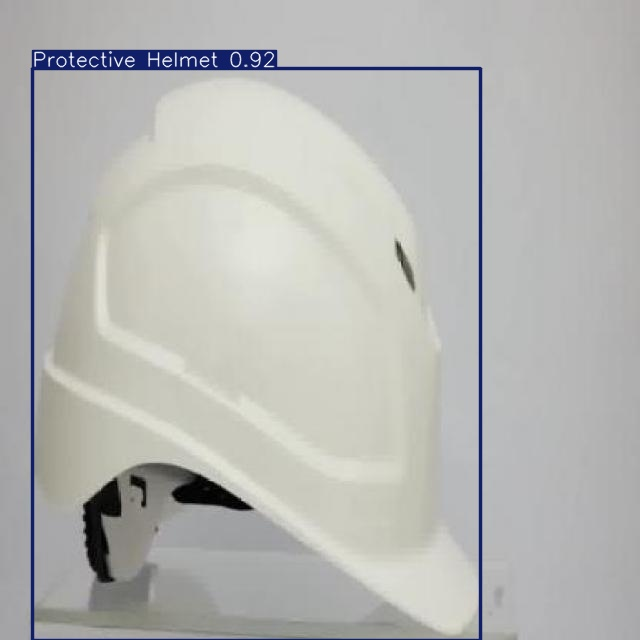

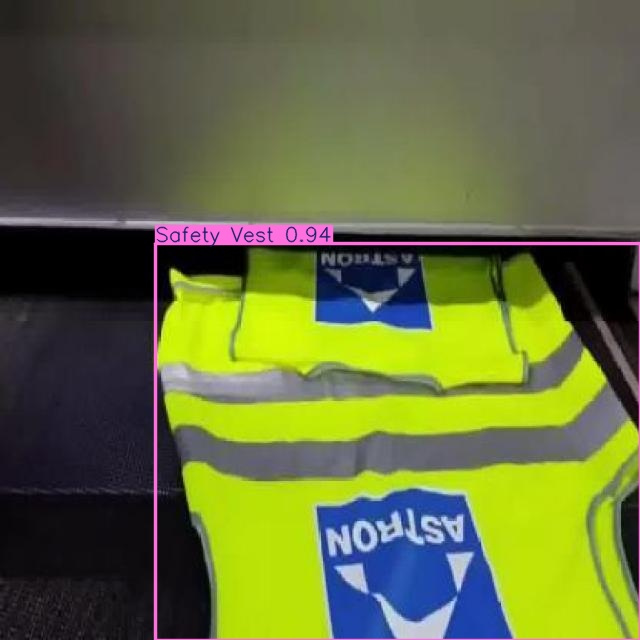

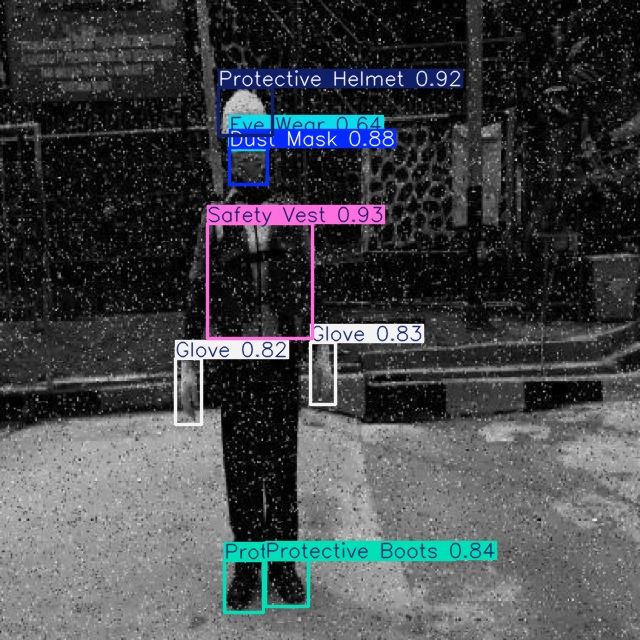

In [18]:
import glob
import os
from IPython.display import Image as IPyImage, display

latest_folder = max(glob.glob('/content/runs/detect/predict*/'), key=os.path.getmtime)
for img in glob.glob(f'{latest_folder}/*.jpg')[1:4]:
    display(IPyImage(filename=img, width=600))
    print("\n")

In [23]:
!gdown "https://drive.google.com/uc?id=1ACZp9gmtjEdIY-SHp8K0xdR0D8Gjd3j3&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1ACZp9gmtjEdIY-SHp8K0xdR0D8Gjd3j3&confirm=t
To: /content/image2.jpg
100% 77.7k/77.7k [00:00<00:00, 3.92MB/s]


In [24]:
!yolo task=detect mode=predict model= best.pt conf=0.25 source=image2.jpg save=True

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,583,517 parameters, 0 gradients, 6.3 GFLOPs

image 1/1 /content/image2.jpg: 640x640 6 Protective Bootss, 3 Protective Helmets, 8 Safety Vests, 10.4ms
Speed: 3.1ms preprocess, 10.4ms inference, 540.7ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict2
💡 Learn more at https://docs.ultralytics.com/modes/predict


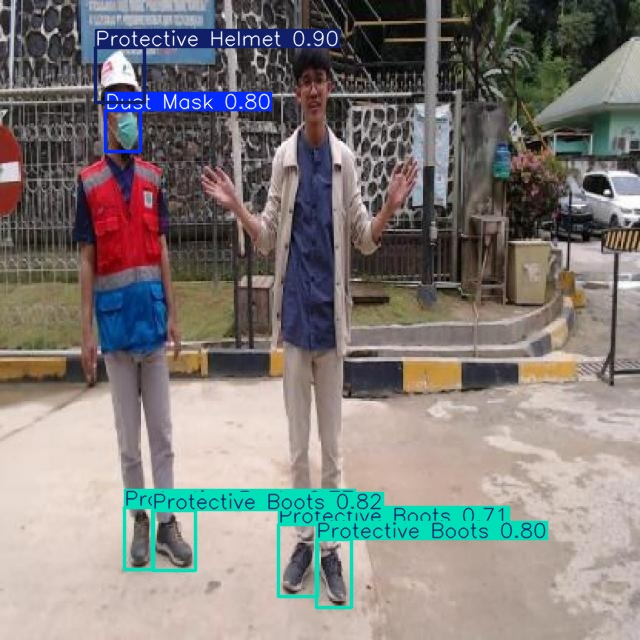

In [20]:
Image("/content/runs/detect/predict/image_102_jpg.rf.a57cc46f5374a99160b4a73d33aff947.jpg", width=600)

In [25]:
!yolo task=detect mode=predict model= best.pt conf=0.25 source="/content/drive/MyDrive/Resources/video5.mp4" save=True

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,583,517 parameters, 0 gradients, 6.3 GFLOPs

video 1/1 (frame 1/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 3 Protective Bootss, 1 Protective Helmet, 6 Safety Vests, 67.4ms
video 1/1 (frame 2/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 2 Protective Bootss, 1 Protective Helmet, 5 Safety Vests, 14.4ms
video 1/1 (frame 3/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 2 Protective Bootss, 2 Protective Helmets, 7 Safety Vests, 12.8ms
video 1/1 (frame 4/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 2 Protective Bootss, 2 Protective Helmets, 9 Safety Vests, 13.6ms
video 1/1 (frame 5/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 2 Protective Bootss, 3 Protective Helmets, 6 Safety Vests, 13.1ms
video 1/1 (frame 6/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 1 Protective Boots, 4 Protective Helmets, 4 

In [26]:
!yolo task=detect mode=predict model= best.pt conf=0.25 source="/content/drive/MyDrive/Resources/video6.mp4" save=True

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,583,517 parameters, 0 gradients, 6.3 GFLOPs

video 1/1 (frame 1/631) /content/drive/MyDrive/Resources/video6.mp4: 416x640 (no detections), 43.4ms
video 1/1 (frame 2/631) /content/drive/MyDrive/Resources/video6.mp4: 416x640 (no detections), 8.8ms
video 1/1 (frame 3/631) /content/drive/MyDrive/Resources/video6.mp4: 416x640 (no detections), 8.8ms
video 1/1 (frame 4/631) /content/drive/MyDrive/Resources/video6.mp4: 416x640 (no detections), 9.5ms
video 1/1 (frame 5/631) /content/drive/MyDrive/Resources/video6.mp4: 416x640 1 Safety Vest, 9.3ms
video 1/1 (frame 6/631) /content/drive/MyDrive/Resources/video6.mp4: 416x640 1 Safety Vest, 9.1ms
video 1/1 (frame 7/631) /content/drive/MyDrive/Resources/video6.mp4: 416x640 (no detections), 9.7ms
video 1/1 (frame 8/631) /content/drive/MyDrive/Resources/video6.mp4: 416x640 (no detections), 9.5ms
video 1/1 (frame 9/631) /content/driv

In [27]:
!rm '/content/result_compressed.mp4'

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [28]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/detect/predict3/video5.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [30]:
!yolo task=detect mode=predict model=best.pt conf=0.25 source="/content/drive/MyDrive/Resources/video5.mp4" save=True

Ultralytics 8.3.13 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11n summary (fused): 238 layers, 2,583,517 parameters, 0 gradients, 6.3 GFLOPs

video 1/1 (frame 1/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 3 Protective Bootss, 1 Protective Helmet, 6 Safety Vests, 72.5ms
video 1/1 (frame 2/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 2 Protective Bootss, 1 Protective Helmet, 5 Safety Vests, 9.2ms
video 1/1 (frame 3/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 2 Protective Bootss, 2 Protective Helmets, 7 Safety Vests, 9.6ms
video 1/1 (frame 4/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 2 Protective Bootss, 2 Protective Helmets, 9 Safety Vests, 9.3ms
video 1/1 (frame 5/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 2 Protective Bootss, 3 Protective Helmets, 6 Safety Vests, 9.4ms
video 1/1 (frame 6/458) /content/drive/MyDrive/Resources/video5.mp4: 384x640 1 Protective Boots, 4 Protective Helmets, 4 Safe

In [32]:
!rm '/content/result_compressed.mp4'

In [33]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/detect/predict5/video5.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)